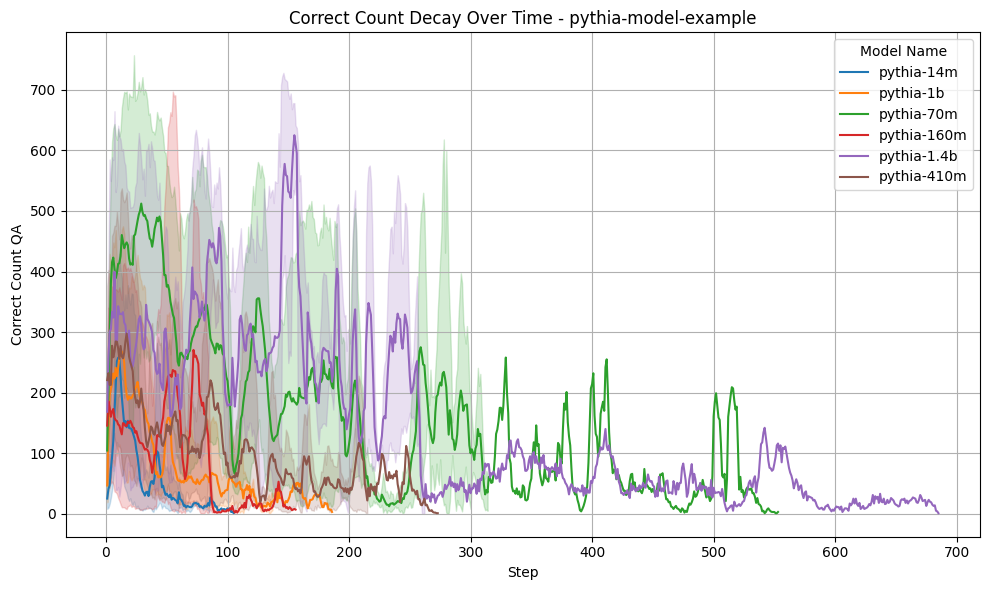

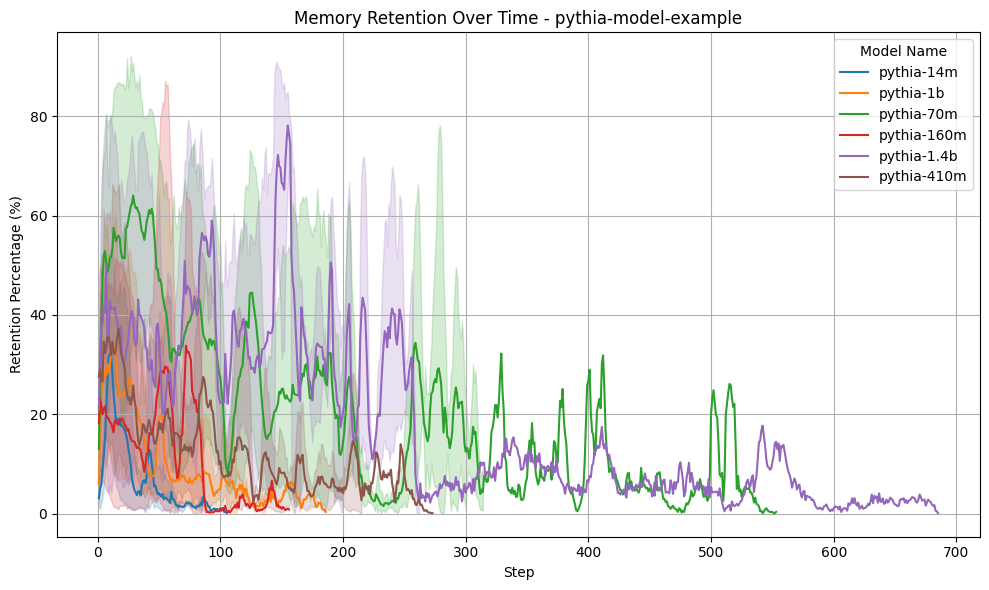

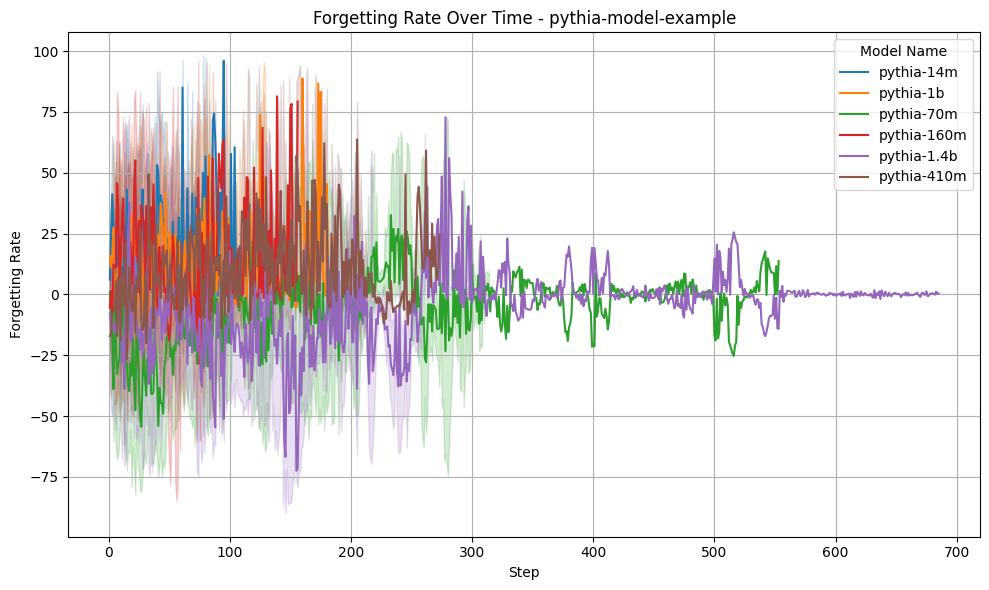

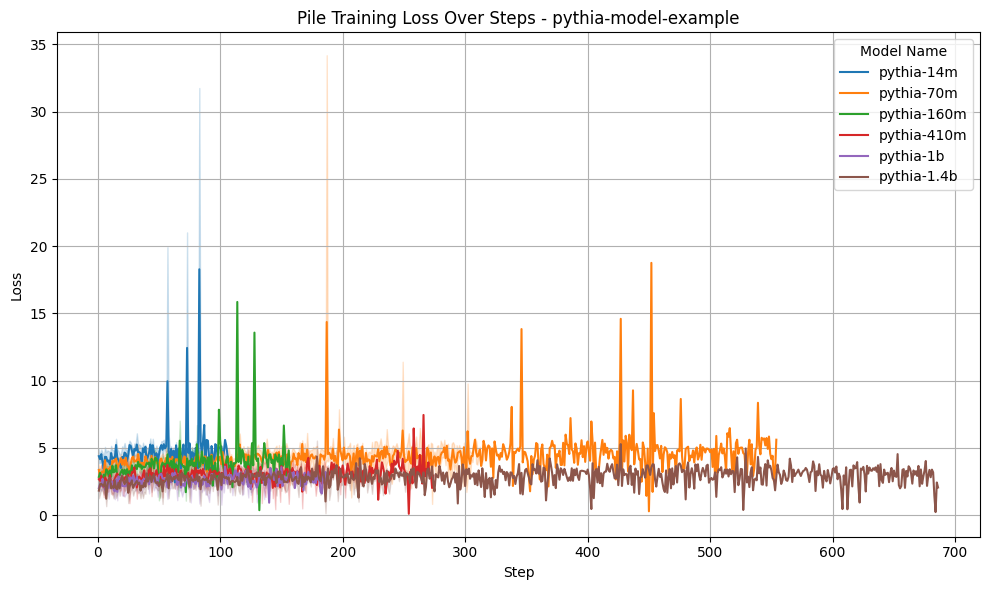

In [12]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Path to experiment folder
experiment_folder = "experiments/single_example_inference_3"

# Load config file (JSON)
def load_config(experiment_folder):
    config_path = os.path.join(experiment_folder, "config.json")
    with open(config_path, 'r') as f:
        cfg = json.load(f)
    return cfg

# Load results data
def load_data(experiment_folder):
    results_path = os.path.join(experiment_folder, "results.csv")
    forgetting_results_path = os.path.join(experiment_folder, "forgetting_results.csv")
    pile_training_loss_path = os.path.join(experiment_folder, "pile_training_loss.csv")
    
    results_df = pd.read_csv(results_path)
    forgetting_df = pd.read_csv(forgetting_results_path)
    pile_loss_df = pd.read_csv(pile_training_loss_path)
    
    return results_df, forgetting_df, pile_loss_df

# Calculate Memory Retention as a percentage
def calculate_memory_retention(forgetting_df, cfg):
    forgetting_df["Retention_Percentage"] = (forgetting_df["Correct Count QA"] / cfg['max_inference_steps']) * 100
    return forgetting_df

# Calculate Forgetting Rate
def calculate_forgetting_rate(forgetting_df):
    forgetting_df = forgetting_df.sort_values(by=["Step"])
    forgetting_df["Forgetting_Rate"] = forgetting_df["Retention_Percentage"].diff().fillna(0) * -1
    return forgetting_df

# Plot Correct Count Decay over Time (Decay of correct answers)
def plot_correct_count_decay(forgetting_df, model_name):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Correct Count QA", hue="Model Name")
    plt.title(f"Correct Count Decay Over Time - {model_name}")
    plt.xlabel("Step")
    plt.ylabel("Correct Count QA")
    plt.legend(title="Model Name")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(experiment_folder, f"{model_name}_correct_count_decay.png"))
    plt.show()

# Plot Memory Retention over Time
def plot_memory_retention(forgetting_df, model_name):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Retention_Percentage", hue="Model Name")
    plt.title(f"Memory Retention Over Time - {model_name}")
    plt.xlabel("Step")
    plt.ylabel("Retention Percentage (%)")
    plt.legend(title="Model Name")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(experiment_folder, f"{model_name}_memory_retention.png"))
    plt.show()

# Plot Forgetting Rate over Time
def plot_forgetting_rate(forgetting_df, model_name):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Forgetting_Rate", hue="Model Name")
    plt.title(f"Forgetting Rate Over Time - {model_name}")
    plt.xlabel("Step")
    plt.ylabel("Forgetting Rate")
    plt.legend(title="Model Name")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(experiment_folder, f"{model_name}_forgetting_rate.png"))
    plt.show()

# Plot Pile Training Loss over Steps
def plot_pile_training_loss(pile_loss_df, model_name):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=pile_loss_df, x="Step", y="Pile Training Loss", hue="Model Name")
    plt.title(f"Pile Training Loss Over Steps - {model_name}")
    plt.xlabel("Step")
    plt.ylabel("Loss")
    plt.legend(title="Model Name")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(experiment_folder, f"{model_name}_pile_loss.png"))
    plt.show()

# Main function to process all the data and plot results
def process_experiment_data(experiment_folder, model_name):
    cfg = load_config(experiment_folder)  # Load the config from JSON
    results_df, forgetting_df, pile_loss_df = load_data(experiment_folder)
    
    # Calculate memory retention and forgetting rates
    forgetting_df = calculate_memory_retention(forgetting_df, cfg)
    forgetting_df = calculate_forgetting_rate(forgetting_df)

    # Generate plots
    plot_correct_count_decay(forgetting_df, model_name)
    plot_memory_retention(forgetting_df, model_name)
    plot_forgetting_rate(forgetting_df, model_name)
    plot_pile_training_loss(pile_loss_df, model_name)

# Run the script
model_name = "pythia-model-example"  # Replace with the specific model name you're working with
process_experiment_data(experiment_folder, model_name)


In [10]:
import os
import pandas as pd
from scipy.stats import binom

# Configuration
cfg = {
    "results_file": "./experiments/baseline_inference/baseline_results.csv",  # Path to baseline results CSV
    "output_folder": "./experiments/baseline_inference/analysis",  # Folder to save analysis outputs
    "confidence_level": 0.90  # 90% confidence level for signal threshold
}

# Create output folder if it doesn't exist
def create_output_folder(output_folder):
    os.makedirs(output_folder, exist_ok=True)

# Load the baseline results from CSV
def load_results(results_file):
    return pd.read_csv(results_file)

# Calculate the error rates and baseline guess rate for each model, QA, and Related QA
def calculate_error_rates(df):
    df['Error Rate QA (%)'] = (df['Correct Count QA'] / df['Total Inferences']) * 100
    df['Error Rate Related QA (%)'] = (df['Correct Count Related QA'] / df['Total Inferences']) * 100
    return df

# Calculate signal thresholds per model and per question using binomial distribution
def calculate_signal_thresholds(df, confidence_level):
    signal_thresholds_qa = []
    signal_thresholds_related = []

    # Iterate through each row (model, question, related question) and calculate thresholds
    for _, row in df.iterrows():
        p_baseline_qa = row['Correct Count QA'] / row['Total Inferences']  # Baseline probability for QA
        p_baseline_related = row['Correct Count Related QA'] / row['Total Inferences']  # Baseline probability for Related QA

        # Calculate the 90% confidence signal threshold using binomial ppf for QA and Related QA
        threshold_qa = binom.ppf(confidence_level, row['Total Inferences'], p_baseline_qa)
        threshold_related = binom.ppf(confidence_level, row['Total Inferences'], p_baseline_related)

        # Convert to percentages
        signal_thresholds_qa.append((threshold_qa / row['Total Inferences']) * 100)
        signal_thresholds_related.append((threshold_related / row['Total Inferences']) * 100)

    # Add the calculated thresholds to the dataframe
    df['Signal Threshold QA (%)'] = signal_thresholds_qa
    df['Signal Threshold Related QA (%)'] = signal_thresholds_related
    return df

# Calculate the average signal thresholds per question
def calculate_average_thresholds(df):
    avg_thresholds = df.groupby('QA Index').agg(
        Avg_Signal_Threshold_QA=('Signal Threshold QA (%)', 'mean'),
        Avg_Signal_Threshold_Related_QA=('Signal Threshold Related QA (%)', 'mean')
    ).reset_index()
    return avg_thresholds

# Save summary as a CSV
def save_summary_to_csv(df, output_folder, filename):
    output_file = os.path.join(output_folder, filename)
    df.to_csv(output_file, index=False)
    print(f"Summary saved to {output_file}")

# Main analysis function
def run_analysis(cfg):
    # Create output folder for analysis
    create_output_folder(cfg['output_folder'])

    # Load the baseline results
    df = load_results(cfg['results_file'])

    # Calculate error rates
    df = calculate_error_rates(df)

    # Calculate signal thresholds per question and model
    df = calculate_signal_thresholds(df, cfg['confidence_level'])

    # Save the detailed signal thresholds and error rates to CSV
    save_summary_to_csv(df, cfg['output_folder'], 'detailed_error_rates_with_thresholds.csv')

    # Calculate average signal thresholds per question
    avg_thresholds_df = calculate_average_thresholds(df)

    # Save the average signal thresholds to CSV
    save_summary_to_csv(avg_thresholds_df, cfg['output_folder'], 'average_error_thresholds.csv')

# Run the analysis
run_analysis(cfg)


Summary saved to ./experiments/baseline_inference/analysis/detailed_error_rates_with_thresholds.csv
Summary saved to ./experiments/baseline_inference/analysis/average_error_thresholds.csv


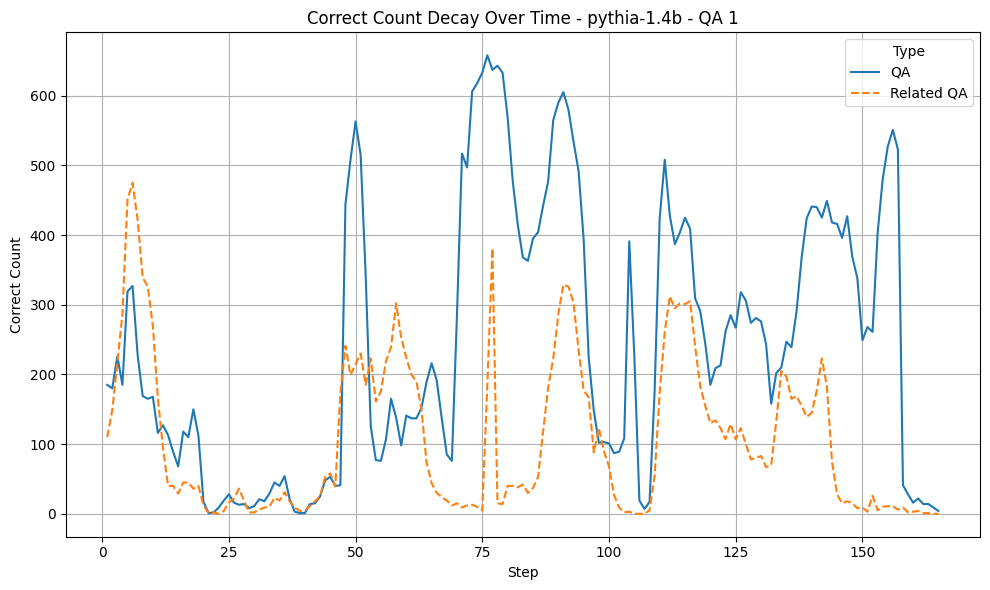

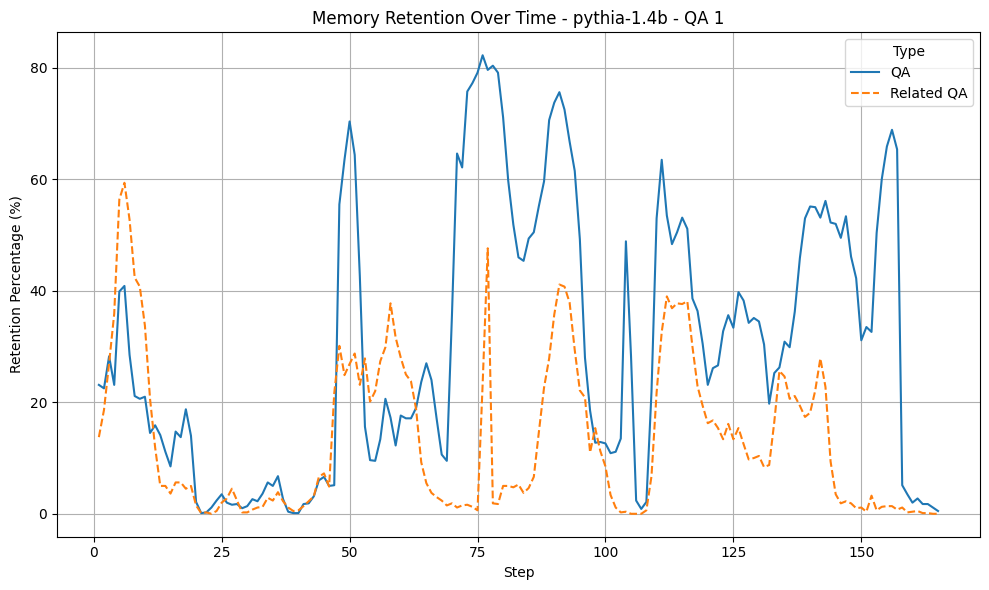

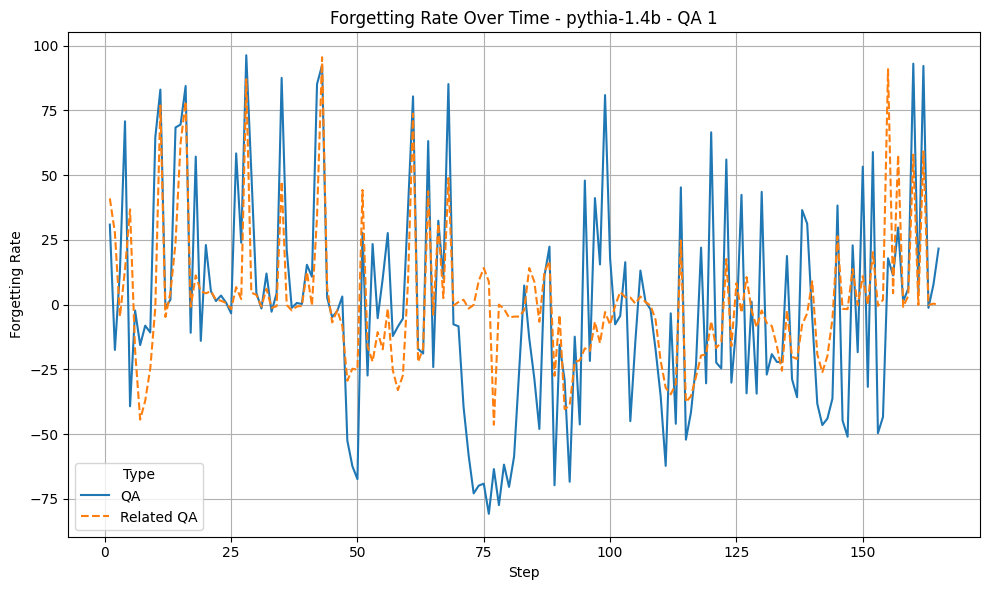

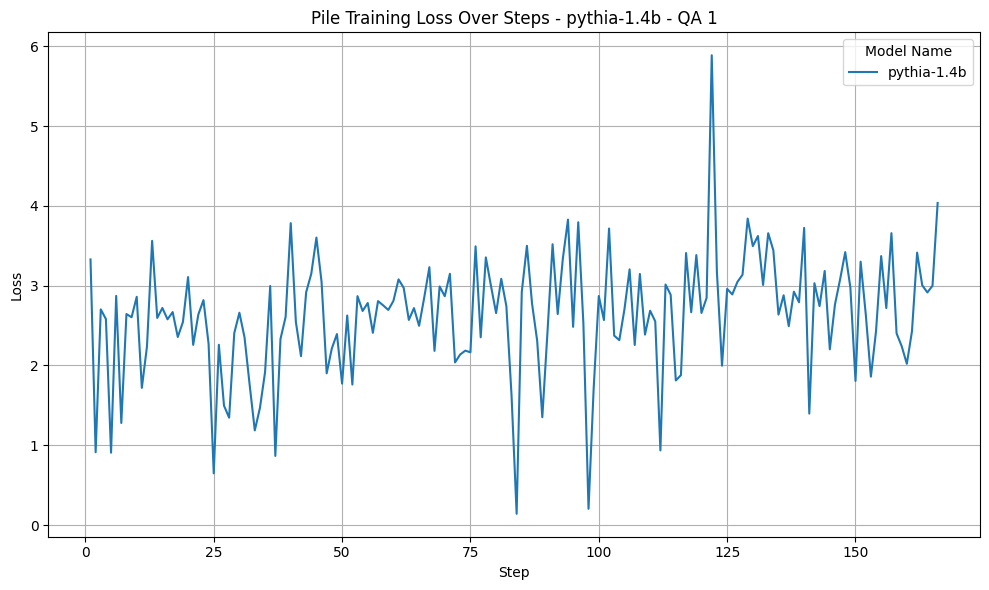

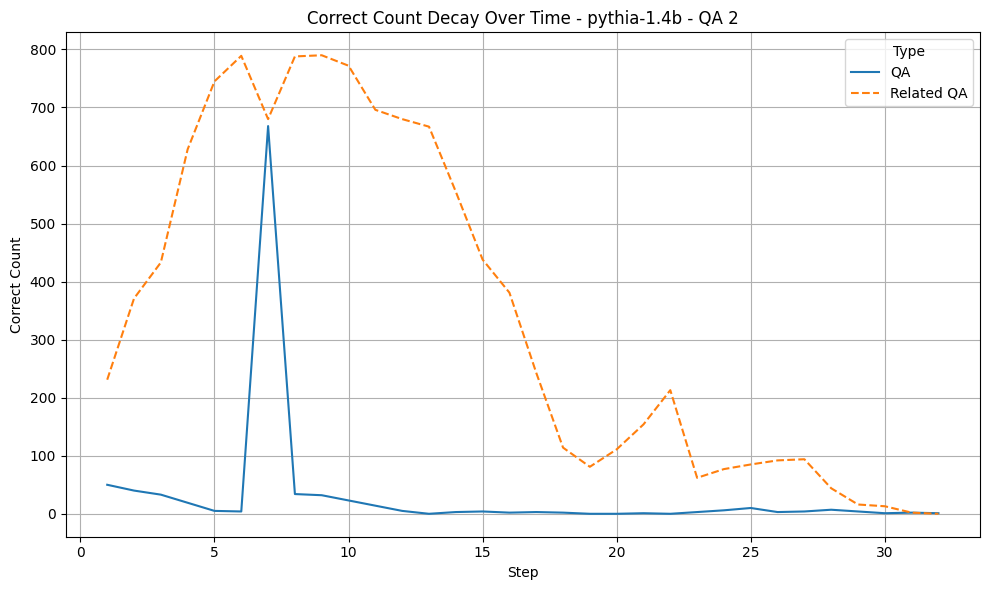

...

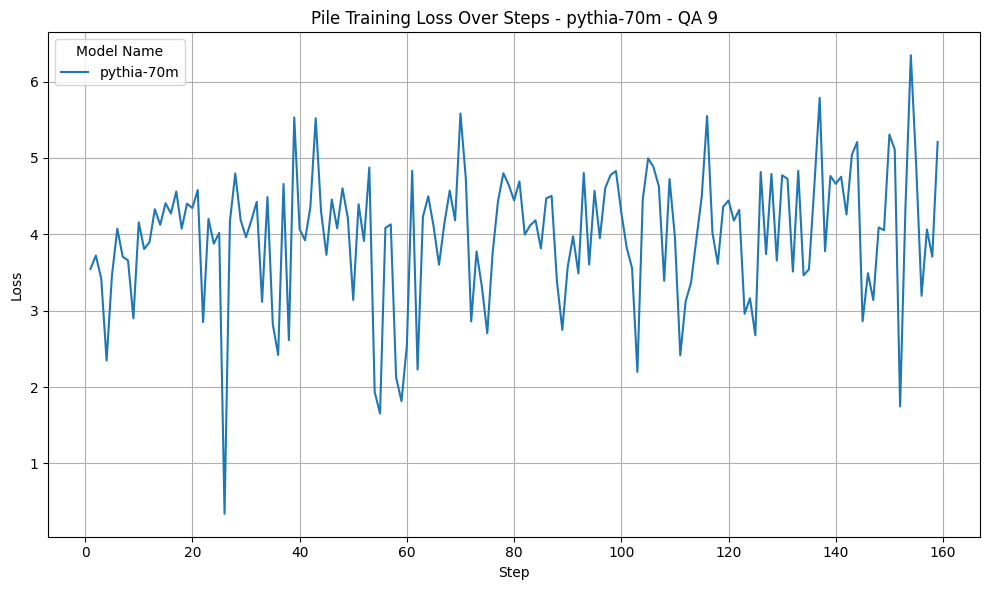

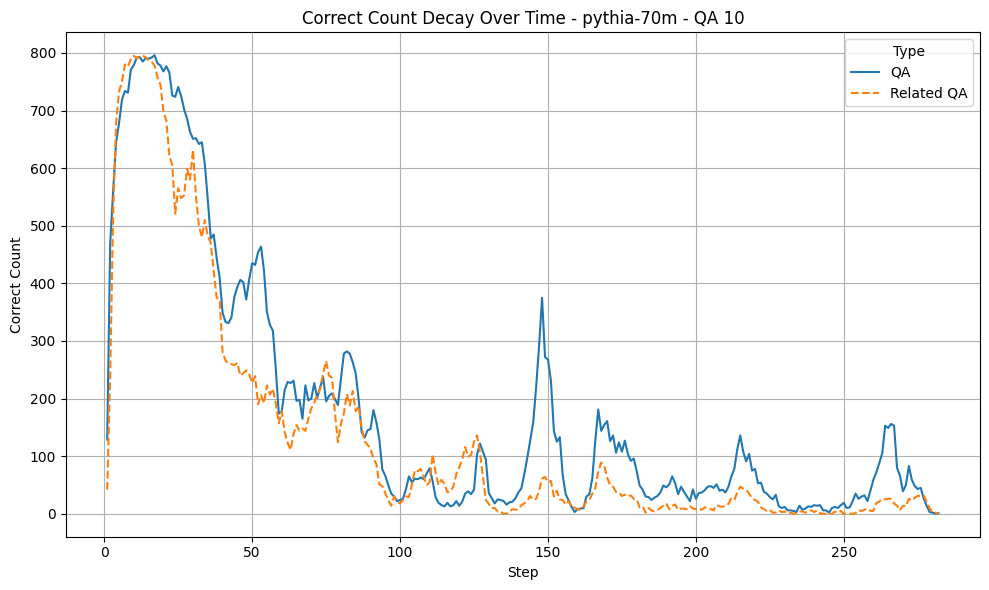

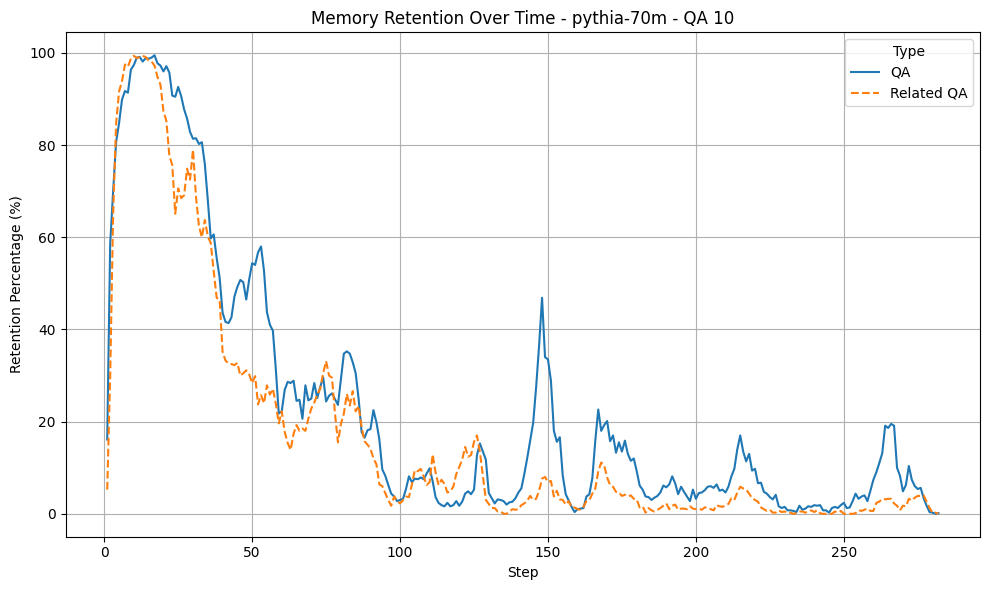

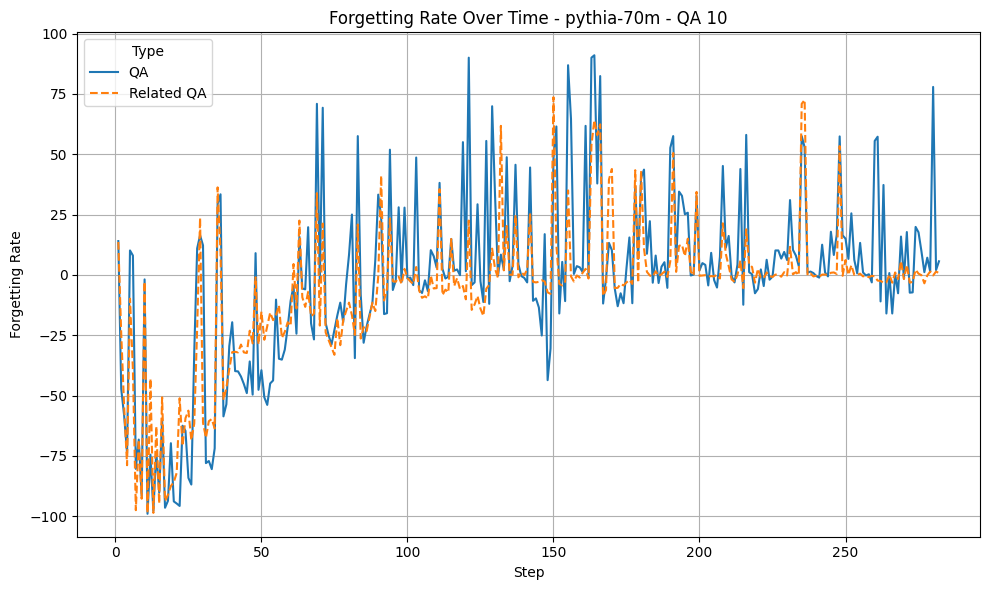

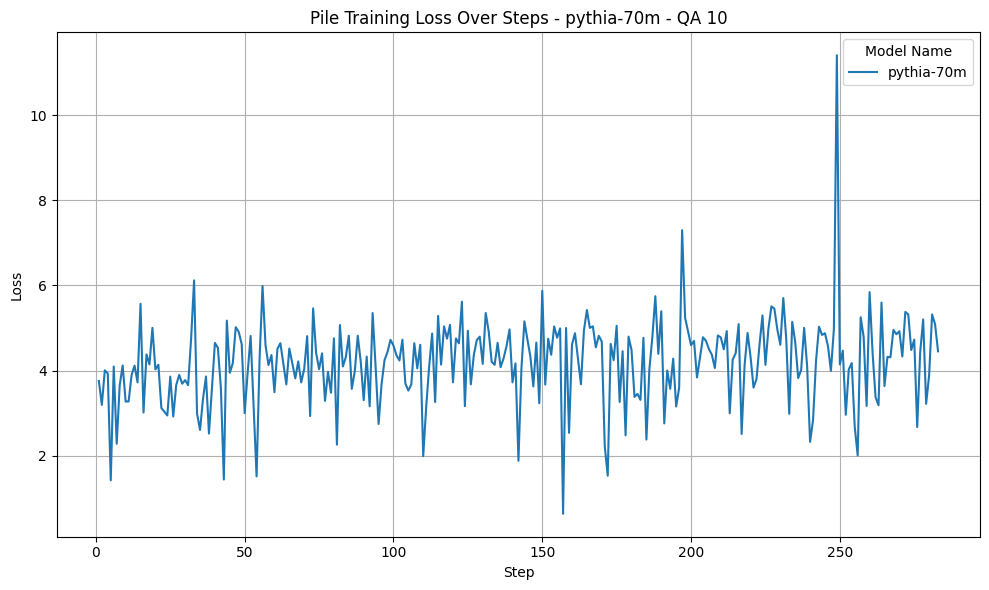

In [18]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Path to experiment folder
experiment_folder = "experiments/single_example_inference_3"
analysis_folder = os.path.join(experiment_folder, "analysis")

# Create the analysis folder if it does not exist
os.makedirs(analysis_folder, exist_ok=True)

# Load config file (JSON)
def load_config(experiment_folder):
    config_path = os.path.join(experiment_folder, "config.json")
    with open(config_path, 'r') as f:
        cfg = json.load(f)
    return cfg

# Load results data
def load_data(experiment_folder):
    results_path = os.path.join(experiment_folder, "results.csv")
    forgetting_results_path = os.path.join(experiment_folder, "forgetting_results.csv")
    pile_training_loss_path = os.path.join(experiment_folder, "pile_training_loss.csv")
    
    results_df = pd.read_csv(results_path)
    forgetting_df = pd.read_csv(forgetting_results_path)
    pile_loss_df = pd.read_csv(pile_training_loss_path)
    
    return results_df, forgetting_df, pile_loss_df

# Calculate Memory Retention as a percentage
def calculate_memory_retention(forgetting_df, cfg):
    forgetting_df["Retention_Percentage_QA"] = (forgetting_df["Correct Count QA"] / cfg['max_inference_steps']) * 100
    forgetting_df["Retention_Percentage_Related_QA"] = (forgetting_df["Correct Count Related QA"] / cfg['max_inference_steps']) * 100
    return forgetting_df

# Calculate Forgetting Rate
def calculate_forgetting_rate(forgetting_df):
    forgetting_df = forgetting_df.sort_values(by=["Step"])
    forgetting_df["Forgetting_Rate_QA"] = forgetting_df["Retention_Percentage_QA"].diff().fillna(0) * -1
    forgetting_df["Forgetting_Rate_Related_QA"] = forgetting_df["Retention_Percentage_Related_QA"].diff().fillna(0) * -1
    return forgetting_df

# Plot Correct Count Decay over Time (Decay of correct answers)
def plot_correct_count_decay(forgetting_df, model_name, qa_index):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Correct Count QA", label="QA")
    sns.lineplot(data=forgetting_df, x="Step", y="Correct Count Related QA", label="Related QA", linestyle="--")
    plt.title(f"Correct Count Decay Over Time - {model_name} - QA {qa_index}")
    plt.xlabel("Step")
    plt.ylabel("Correct Count")
    plt.legend(title="Type")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(analysis_folder, f"{model_name}_qa_{qa_index}_correct_count_decay.png"))
    plt.show()

# Plot Memory Retention over Time
def plot_memory_retention(forgetting_df, model_name, qa_index):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Retention_Percentage_QA", label="QA")
    sns.lineplot(data=forgetting_df, x="Step", y="Retention_Percentage_Related_QA", label="Related QA", linestyle="--")
    plt.title(f"Memory Retention Over Time - {model_name} - QA {qa_index}")
    plt.xlabel("Step")
    plt.ylabel("Retention Percentage (%)")
    plt.legend(title="Type")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(analysis_folder, f"{model_name}_qa_{qa_index}_memory_retention.png"))
    plt.show()

# Plot Forgetting Rate over Time
def plot_forgetting_rate(forgetting_df, model_name, qa_index):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=forgetting_df, x="Step", y="Forgetting_Rate_QA", label="QA")
    sns.lineplot(data=forgetting_df, x="Step", y="Forgetting_Rate_Related_QA", label="Related QA", linestyle="--")
    plt.title(f"Forgetting Rate Over Time - {model_name} - QA {qa_index}")
    plt.xlabel("Step")
    plt.ylabel("Forgetting Rate")
    plt.legend(title="Type")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(analysis_folder, f"{model_name}_qa_{qa_index}_forgetting_rate.png"))
    plt.show()

# Plot Pile Training Loss over Steps
def plot_pile_training_loss(pile_loss_df, model_name, qa_index):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=pile_loss_df, x="Step", y="Pile Training Loss", hue="Model Name")
    plt.title(f"Pile Training Loss Over Steps - {model_name} - QA {qa_index}")
    plt.xlabel("Step")
    plt.ylabel("Loss")
    plt.legend(title="Model Name")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(analysis_folder, f"{model_name}_qa_{qa_index}_pile_loss.png"))
    plt.show()

# Main function to process all the data and plot results
def process_experiment_data(experiment_folder):
    cfg = load_config(experiment_folder)  # Load the config from JSON
    results_df, forgetting_df, pile_loss_df = load_data(experiment_folder)
    
    # Calculate memory retention and forgetting rates
    forgetting_df = calculate_memory_retention(forgetting_df, cfg)
    forgetting_df = calculate_forgetting_rate(forgetting_df)
    
    # Group data by "Model Name" and "QA Index" and plot for each QA and model
    grouped_forgetting = forgetting_df.groupby(['Model Name', 'QA Index'])
    grouped_pile = pile_loss_df.groupby(['Model Name', 'QA Index'])

    for (model_name, qa_index), forgetting_group in grouped_forgetting:
        # Plot each QA data group separately, for each model
        plot_correct_count_decay(forgetting_group, model_name, qa_index)
        plot_memory_retention(forgetting_group, model_name, qa_index)
        plot_forgetting_rate(forgetting_group, model_name, qa_index)
    
        # Get the corresponding pile loss data for the same QA index and model name
        if (model_name, qa_index) in grouped_pile.groups:
            pile_group = grouped_pile.get_group((model_name, qa_index))
            plot_pile_training_loss(pile_group, model_name, qa_index)

# Run the script
process_experiment_data(experiment_folder)
